# Example notebook using the event display for the IWCD mPMT CNN dataset

This notebook uses the IWCD geometry uses mPMTs, for the mPMT CNN dataset.

The same setup and code should work for other detectors using the mPMT CNN dataset, e.g. for WCTE, with minimal modifications.


Plot are included of example events in 2D and 3D, and plots of variables related to the detector geometry to check that the mapping to the CNN image appears correct.

## Imports and setup

First change some display settings for the notebook

In [1]:
from IPython.display import display, HTML, Markdown
display(HTML("<style>.container { width:100% !important; }</style>"))
display(HTML("<style>div.output_scroll { height: 44em; }</style>"))

External imports:

In [2]:
import sys
import matplotlib

Import WatChMaL analysis code

In [3]:
# either add WatChMaL repository directory to PYTHONPATH environment variable or add it here
sys.path.append('/home/junjiex/pro-junjiex/WatChMaL')

In [4]:
from analysis.event_display.cnn_mpmt_event_display import CNNmPMTEventDisplay

Imported analysis code from WatChMaL repository with git version: 6e93f0b


## Set up event display with dataset

The `CNNmPMTEventDisplay` initialiser is the same as the `CNNmPMTDataset` initialiser:

In [6]:
help(CNNmPMTEventDisplay.__init__)

Help on function __init__ in module watchmal.dataset.cnn_mpmt.cnn_mpmt_dataset:

__init__(self, h5file, mpmt_positions_file, padding_type=None, transforms=None, collapse_arrays=False)
    Constructs a dataset for CNN data. Event hit data is read in from the HDF5 file and the PMT charge data is
    formatted into an event-display-like image for input to a CNN. Each pixel of the image corresponds to one mPMT
    module, with channels corresponding to each PMT within the mPMT. The mPMTs are placed in the image according to
    a mapping provided by the numpy array in the `mpmt_positions_file`.
    
    Parameters
    ----------
    h5file: string
        Location of the HDF5 file containing the event data
    mpmt_positions_file: string
        Location of a npz file containing the mapping from mPMT IDs to CNN image pixel locations
    transforms: sequence of string
        List of random transforms to apply to data before passing to CNN for data augmentation. Each element of the
        

Create an instance:

In [5]:
event_display = CNNmPMTEventDisplay(h5file='/home/junjiex/pro-junjiex/WatChMaL/outputs/WCTE_MC/WCTEmPMT_test/h5/WCTEmPMT_test_mu-_E100to1500MeV_fix-pos-x0-y0-z0_4pi_10kevts.h5',
                                    mpmt_positions_file='/scratch/junjiex/WCTE/WCTE_mPMT_image_positions.npz')

## Set up plotting style

Set the notebook's embedded figure format

In [6]:
%config InlineBackend.figure_formats = ['png']

Set some default matplotlib style settings

In [7]:
font = {'family' : 'DejaVu Sans',
        'weight' : 'normal',
        'size'   : 28}
matplotlib.rc('font', **font)
matplotlib.rcParams['figure.figsize'] = (15, 12)
matplotlib.rcParams["figure.autolayout"] = True

## Display events

The 2D event display plots exactly the data produced by the Dataset class and passed to the CNN. How to use it:

In [13]:
help(CNNmPMTEventDisplay.plot_event_2d)

Help on function plot_event_2d in module analysis.event_display.cnn_mpmt_event_display:

plot_event_2d(self, event, transformations=None, **kwargs)
    Plots an event as a 2D event-display-like image.
    
    Parameters
    ----------
    event : int
        index of the event to plot
    transformations : function or str or sequence of function or str, optional
        Transformation function, or the name of a method of this class, or a sequence of functions or method names
        to apply to the event data, such as those used for augmentation.
    kwargs : optional
        Additional arguments to pass to `analysis.event_display.plot_event_2d`
        Valid arguments are:
        fig_width : scalar, optional
            Width of the figure
        title : str, default: None
            Title of the plot
        style : str, optional
            matplotlib style
        color_label: str, default: "Charge"
            Label to print next to the color scale
        color_map : str or C

For example, plotting event number 8 in both default and `dark_background` matplotlib styles:

Number of hit pmts in this event (600,)
Shape of mpmt position map (106, 2)
Number of hit npmts in this event (600,) 19
Number of hit pmts in this event (600,)
Shape of mpmt position map (106, 2)
Number of hit npmts in this event (600,) 19


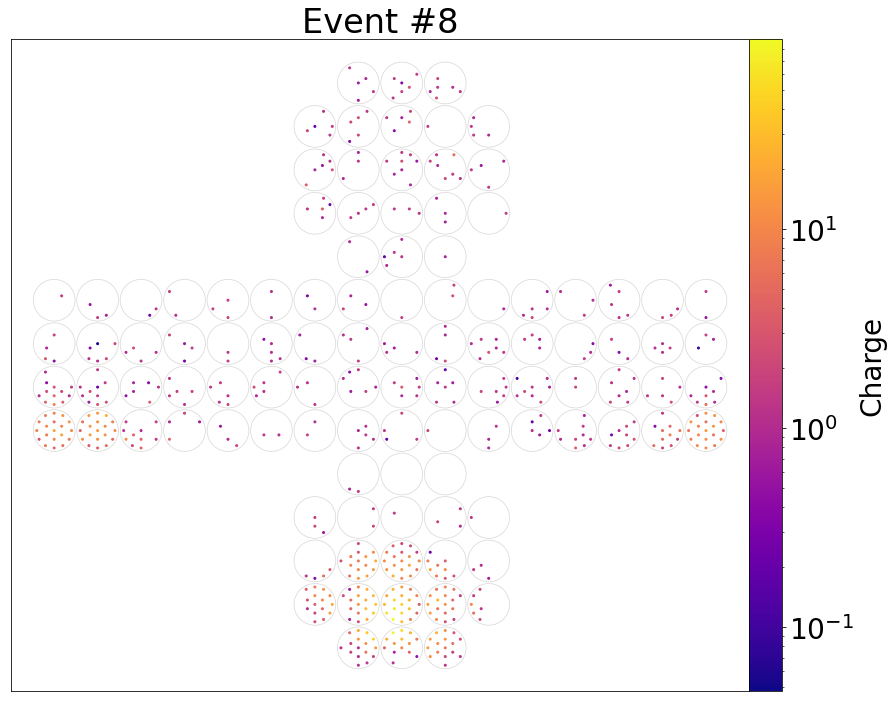

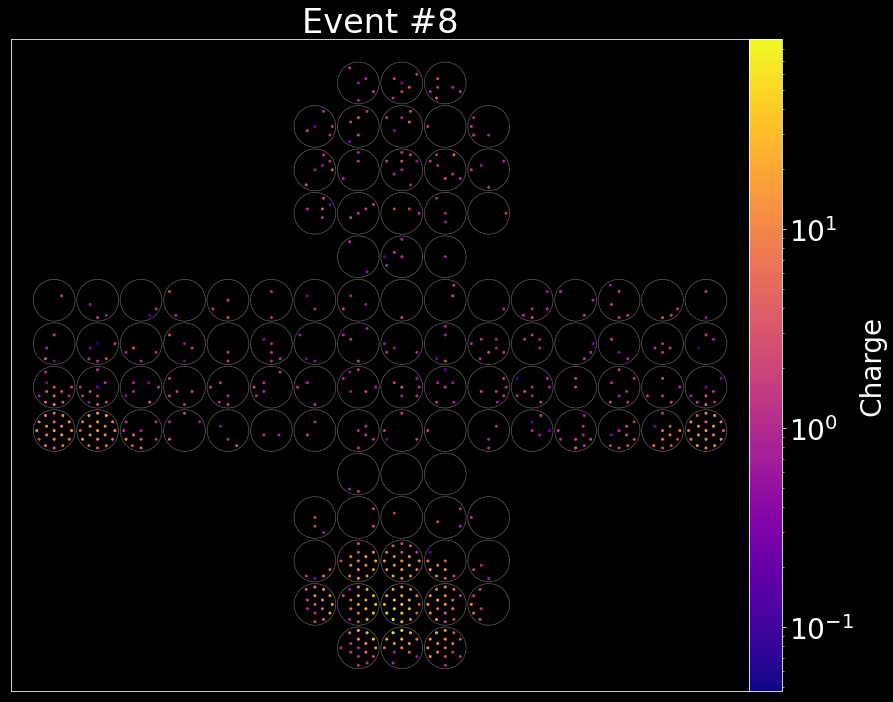

In [8]:
event_id_to_plot = 8
fig, ax = event_display.plot_event_2d(event_id_to_plot, color_label="Charge", title=f"Event #{event_id_to_plot}")
fig, ax = event_display.plot_event_2d(event_id_to_plot, color_label="Charge", title=f"Event #{event_id_to_plot}", style='dark_background')

And with some transformations applied to the data before plotting:

Number of hit pmts in this event (600,)
Shape of mpmt position map (106, 2)
Number of hit npmts in this event (600,) 19
Number of hit pmts in this event (600,)
Shape of mpmt position map (106, 2)
Number of hit npmts in this event (600,) 19


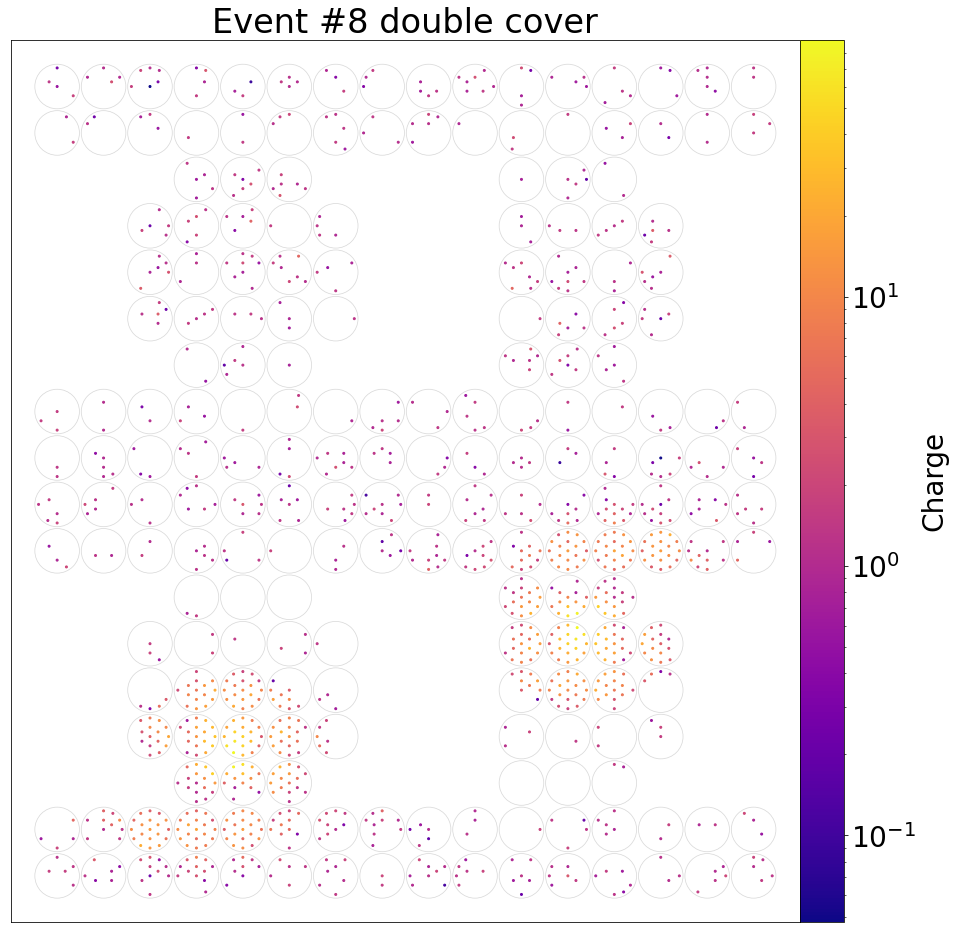

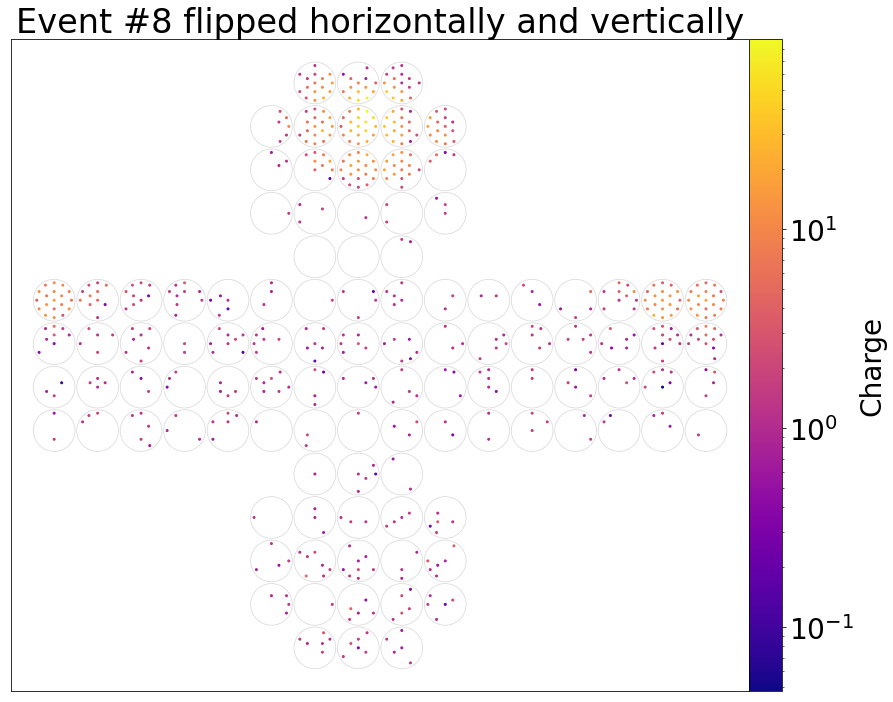

In [9]:
fig, ax = event_display.plot_event_2d(event_id_to_plot, color_label="Charge",
                                      title=f"Event #{event_id_to_plot} double cover",
                                      transformations="double_cover")
fig, ax = event_display.plot_event_2d(event_id_to_plot, color_label="Charge",
                                      title=f"Event #{event_id_to_plot} flipped horizontally and vertically",
                                      transformations=["horizontal_flip", "vertical_flip"])

Another version with different colour map on linear scale

Number of hit pmts in this event (600,)
Shape of mpmt position map (106, 2)
Number of hit npmts in this event (600,) 19


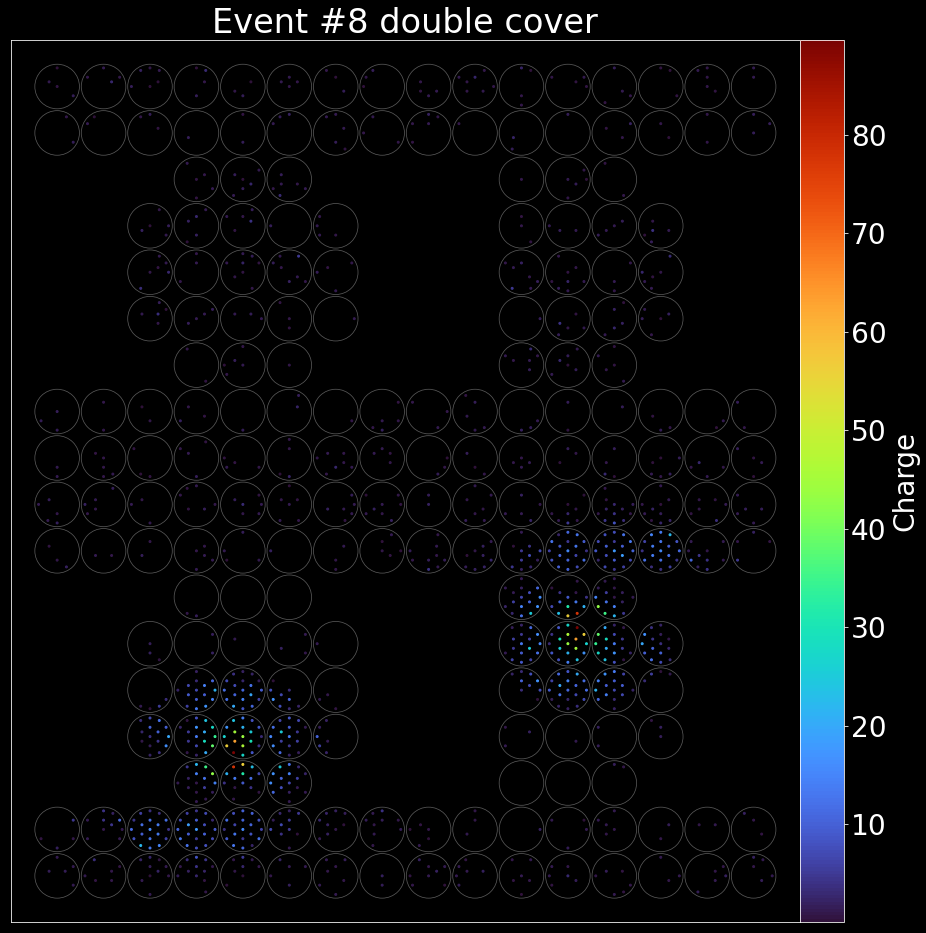

In [10]:
fig, ax = event_display.plot_event_2d(event_id_to_plot, color_label="Charge",
                                      title=f"Event #{event_id_to_plot} double cover",
                                      transformations="double_cover",
                                      style='dark_background',
                                      color_norm=None,
                                      color_map=matplotlib.pyplot.cm.turbo)

The 3D event display function takes the data and plots it in 3D instead. Note that this is not how the data is passed to the CNN, so is less useful for debugging the Dataset code, but stull useful for investigating the data itself.

In [13]:
help(CNNmPMTEventDisplay.plot_event_3d)

Help on function plot_event_3d in module analysis.event_display.cnn_mpmt_event_display:

plot_event_3d(self, event, geometry_file_path, **kwargs)
    Plots an event as a 3D event-display-like image.
    
    Parameters
    ----------
    event : int
        index of the event to plot
    geometry_file_path : str
        path to the file containing 3D geometry of detector
    kwargs : optional
        Additional arguments to pass to `analysis.event_display.plot_event_3d`
        Valid arguments are:
        fig_size : (float, float), optional
            Size of the figure
        zoom : float, default: 1.4
            Zoom factor to enlarge the 3D drawing
        title : str, default: None
            Title of the plot
        style : str, optional
            matplotlib style
        color_label: str, default: "Charge"
            Label to print next to the color scale
        color_map : str or Colormap, default: plt.cm.plasma
            Color map to use when plotting the data
     

Again, plotting event 8 in both styles:

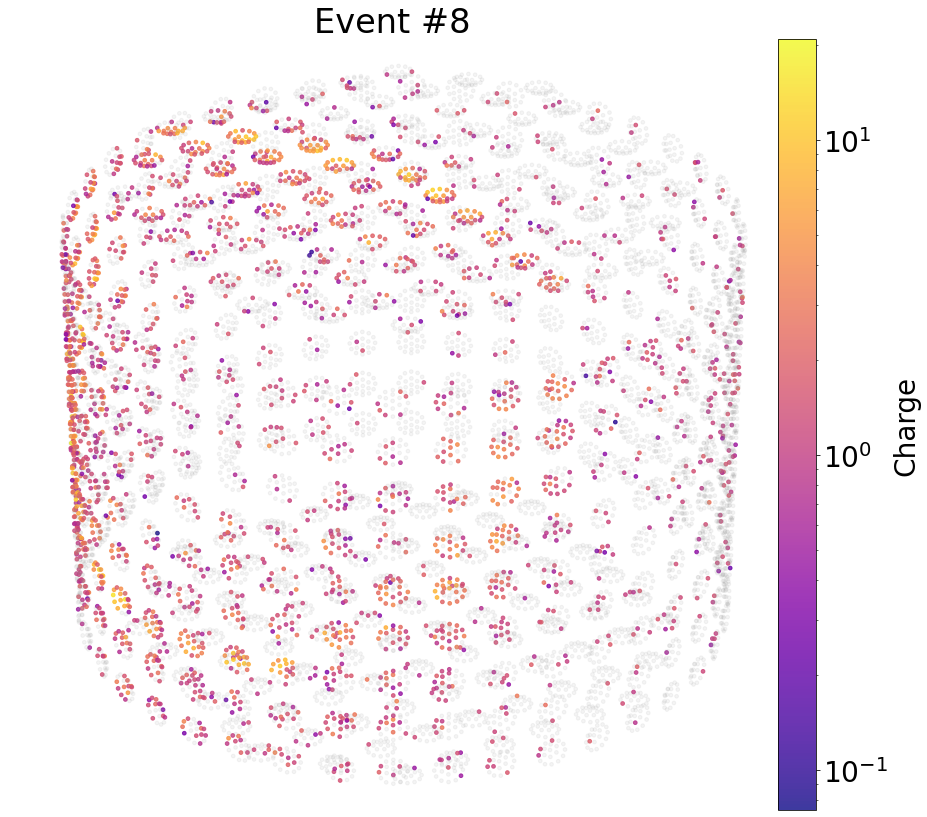

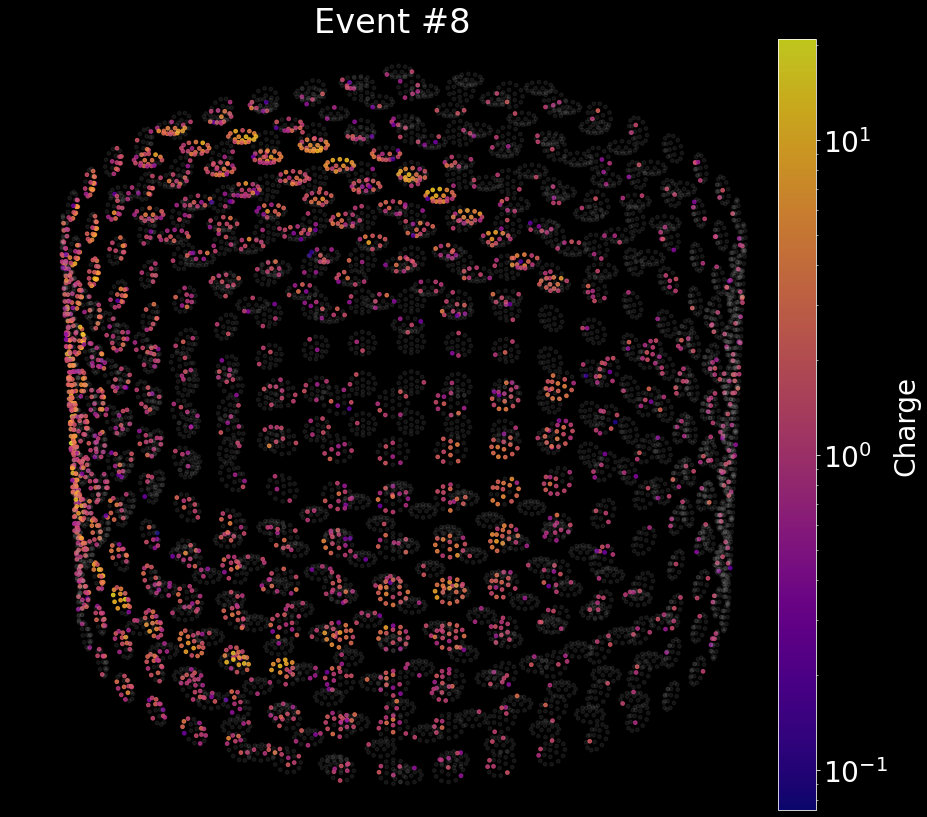

In [14]:
geo_positions_filename = "/fast_scratch/WatChMaL/data/geometries/geo_mPMTshort.npz"
fig, ax = event_display.plot_event_3d(event_id_to_plot, geo_positions_filename, color_label="Charge", title=f"Event #{event_id_to_plot}", view_azimuth=-120, view_elevation=30)
fig, ax = event_display.plot_event_3d(event_id_to_plot, geo_positions_filename, color_label="Charge", title=f"Event #{event_id_to_plot}", view_azimuth=-120, view_elevation=30, style="dark_background")

### Display the detector geometry
There are some extra functions for plotting various geometric quantities, to help debug the detaset:

In [15]:
help(CNNmPMTEventDisplay.plot_geometry_2d)

Help on function plot_geometry_2d in module analysis.event_display.cnn_mpmt_event_display:

plot_geometry_2d(self, geometry_file_path, plot=('x', 'y', 'z'), **kwargs)
    Calls `CNNmPMTEventDisplay.plot_geometry` with `view='2d'`.
    See documentation of `CNNmPMTEventDisplay.plot_geometry`.



In [16]:
help(CNNmPMTEventDisplay.plot_geometry_3d)

Help on function plot_geometry_3d in module analysis.event_display.cnn_mpmt_event_display:

plot_geometry_3d(self, geometry_file_path, plot=('x', 'y', 'z'), **kwargs)
    Calls `CNNmPMTEventDisplay.plot_geometry` with `view='3d'`.
    See documentation of `CNNmPMTEventDisplay.plot_geometry`.



In [17]:
help(CNNmPMTEventDisplay.plot_geometry)

Help on function plot_geometry in module analysis.event_display.cnn_mpmt_event_display:

plot_geometry(self, geometry_file_path, plot=('x', 'y', 'z'), view='2d', **kwargs)
    Produces plots of detector geometry in 2D or 3D.
    
    Parameters
    ----------
    geometry_file_path : str
        path to the file containing 3D geometry of detector
    plot : str or sequence of str, optional
        The quantity to use to color the points corresponding to PMTs in the plot(s). This can be either as one of or a
        sequence of the following values. If a sequence is given, then a plot is produced for each element.
        ====== =======================================================================================
        `plot` color of each PMT marker in the plot
        ====== =======================================================================================
        '1'    The value 1 for all PMTs, to get the same colour at each PMT
        'i'    The ID of the PMT
        'x' 

View the geometry in 2D to check the dataset is working:

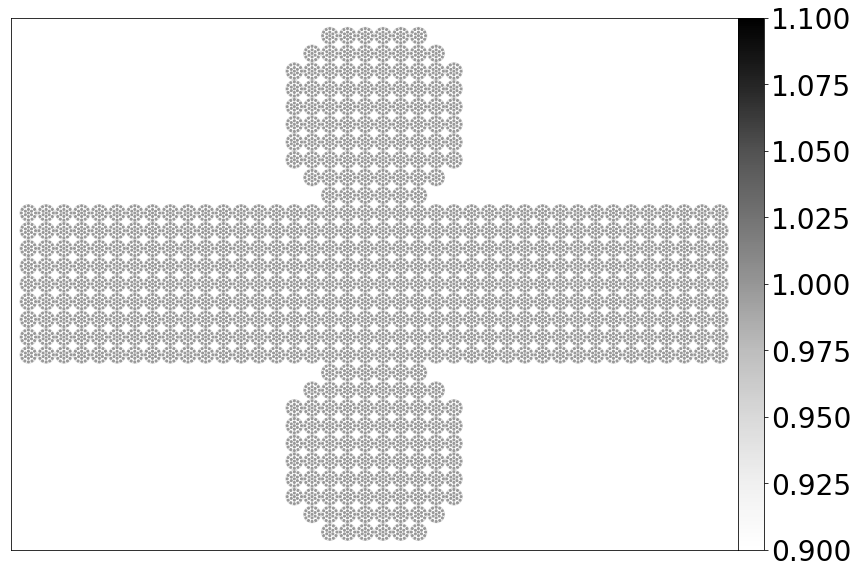

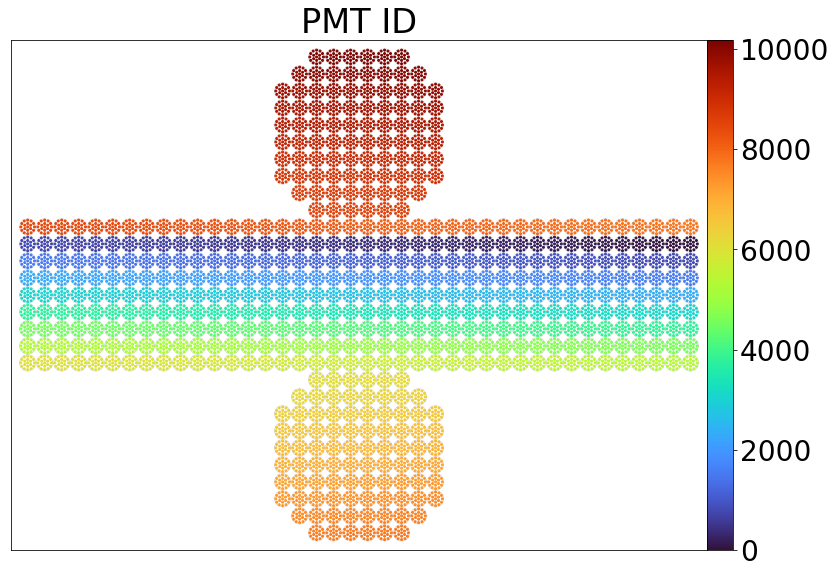

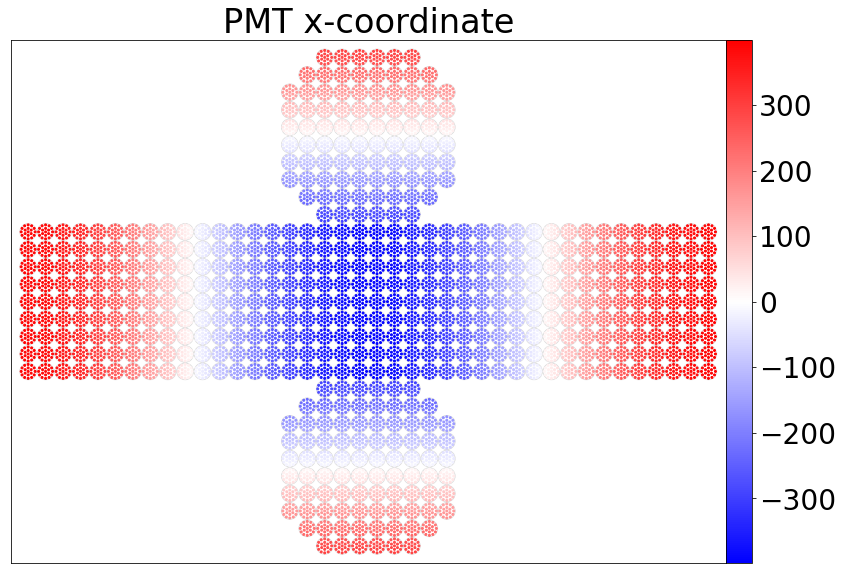

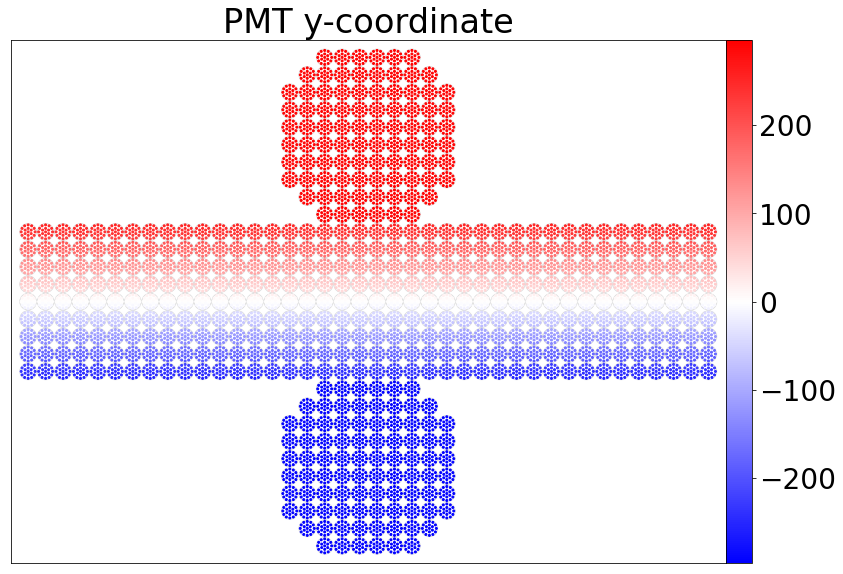

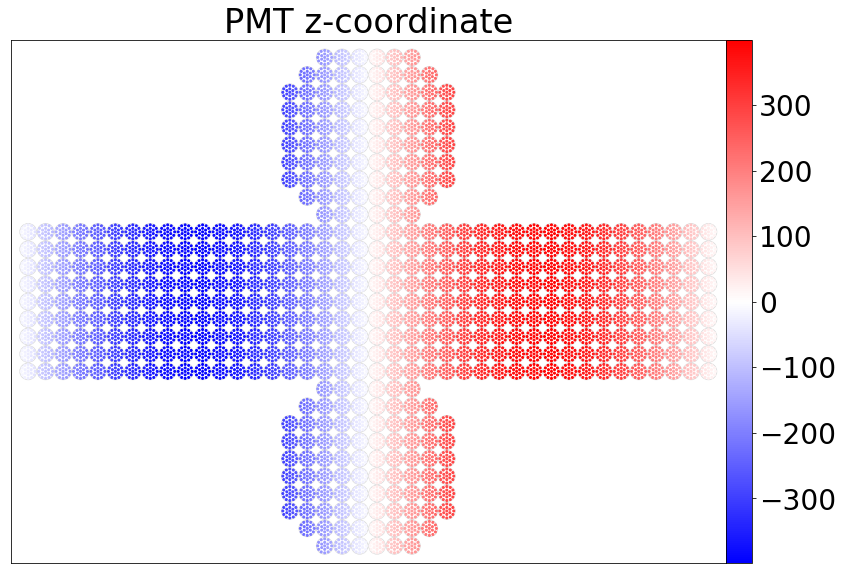

...

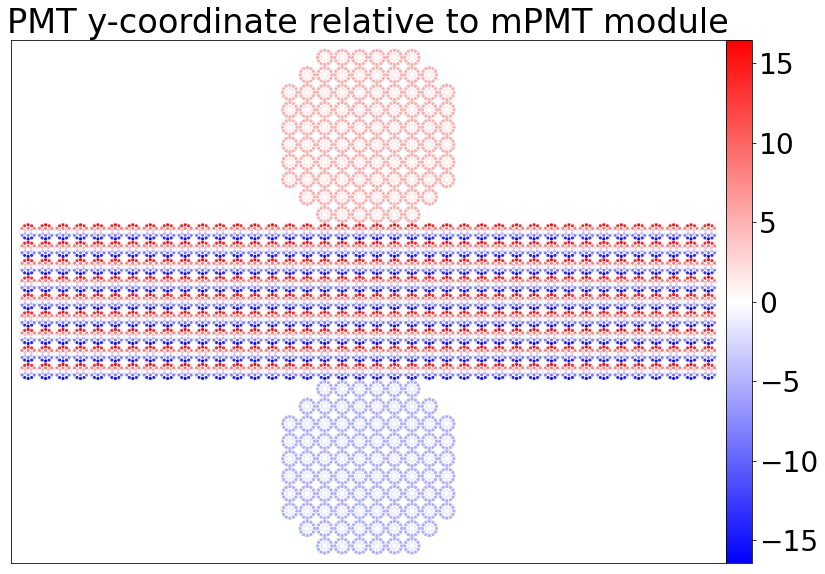

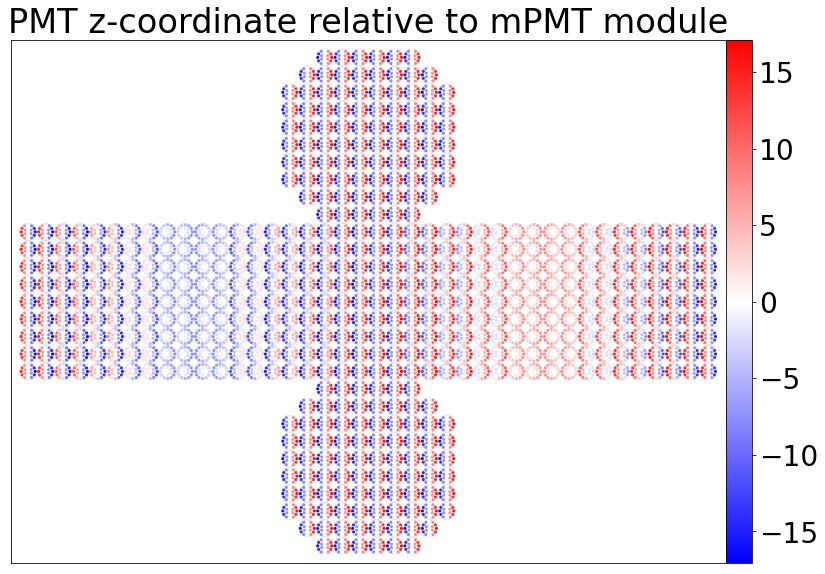

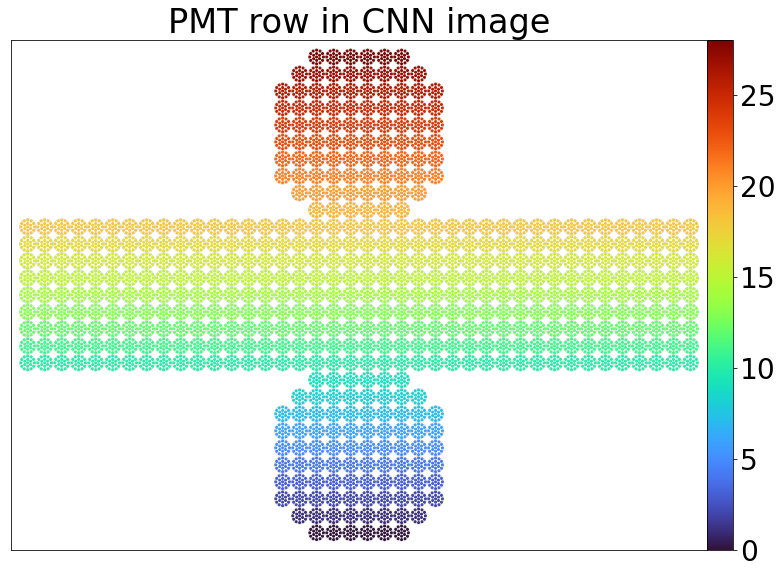

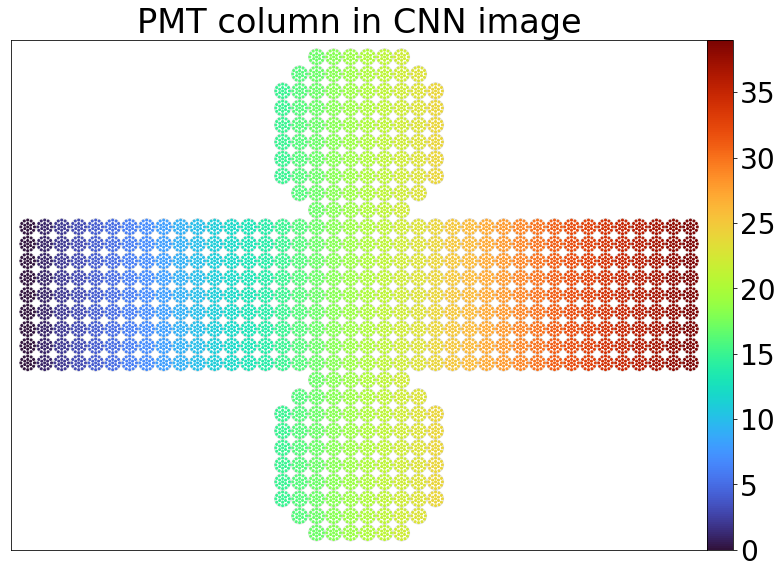

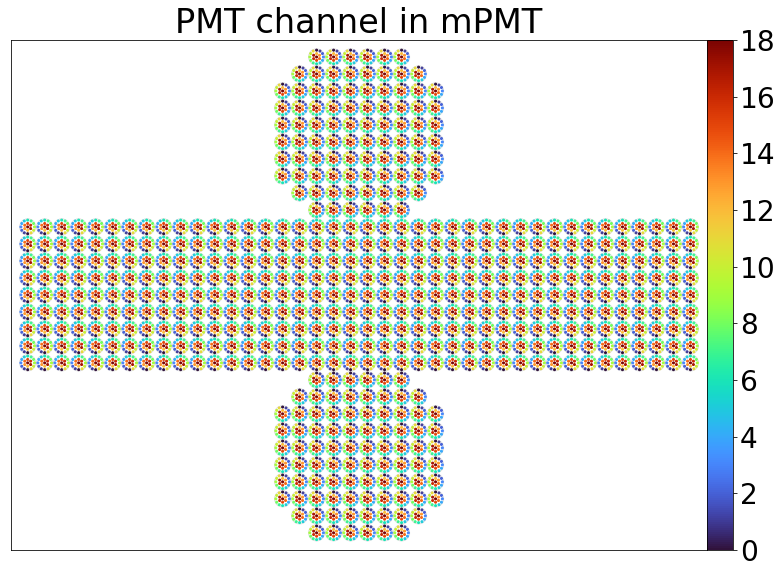

In [18]:
figs, axes = event_display.plot_geometry_2d(geo_positions_filename, plot=('1','i','x','y','z','dx','dy','dz','mx','my','mz','ir','ic','ch'))

View the geometry in 2D to check the geometry looks correct: 

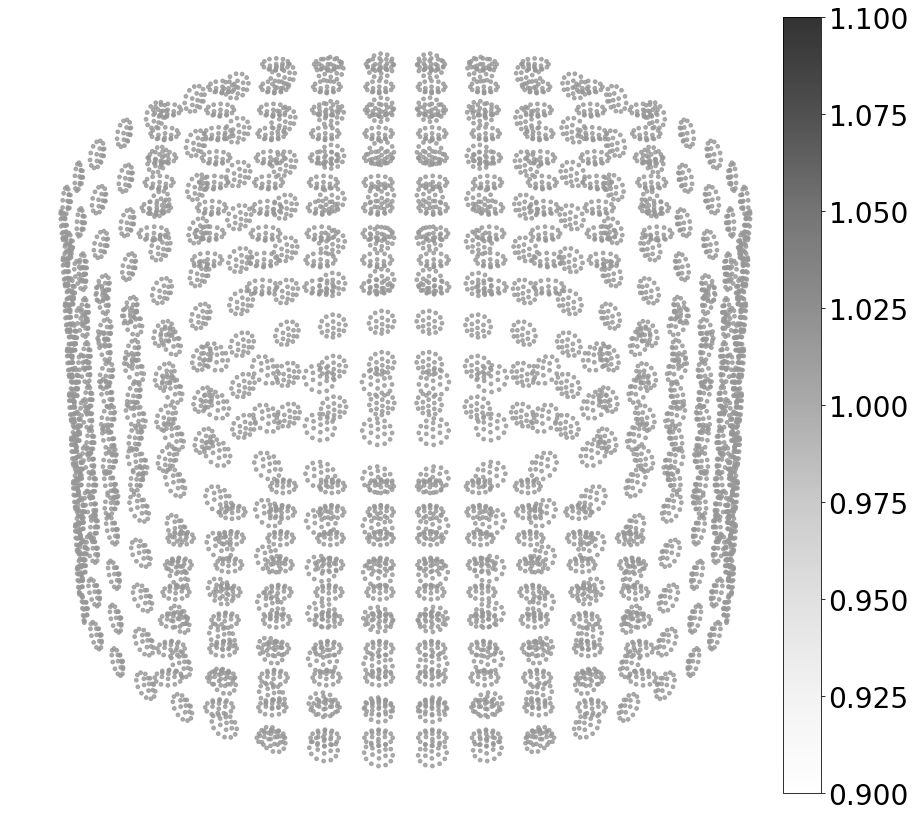

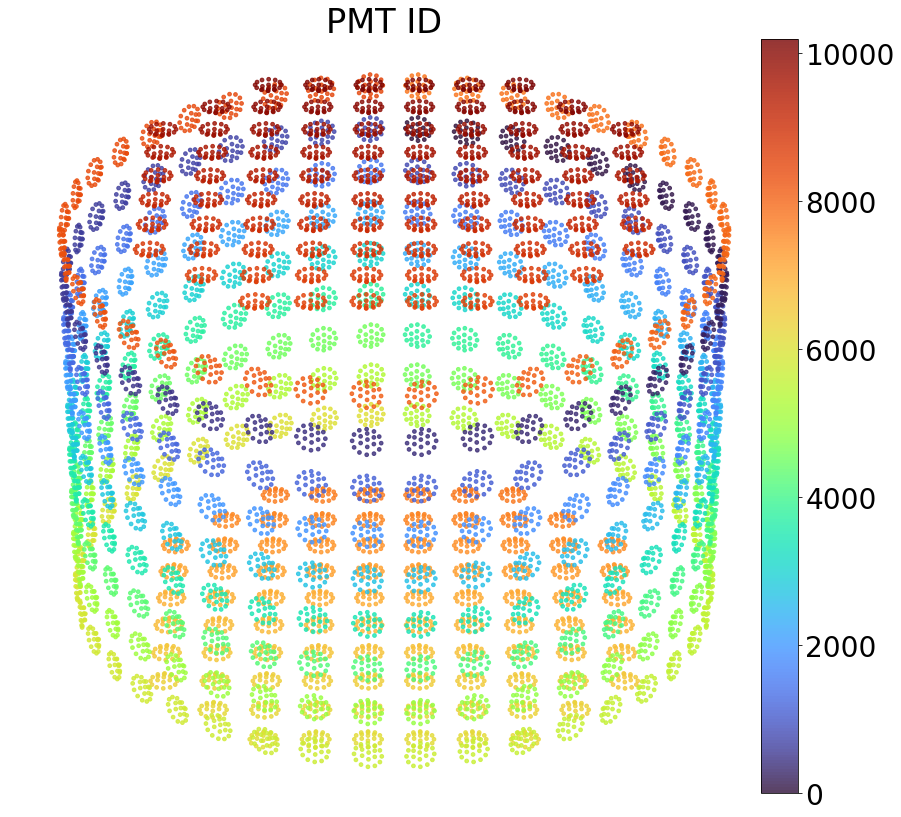

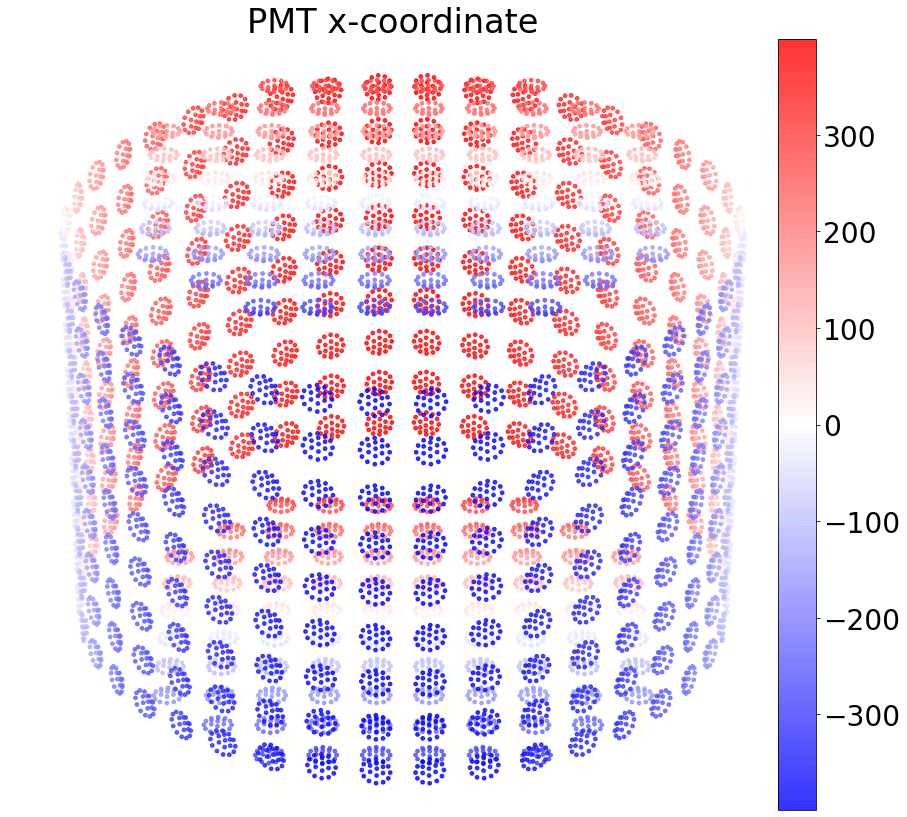

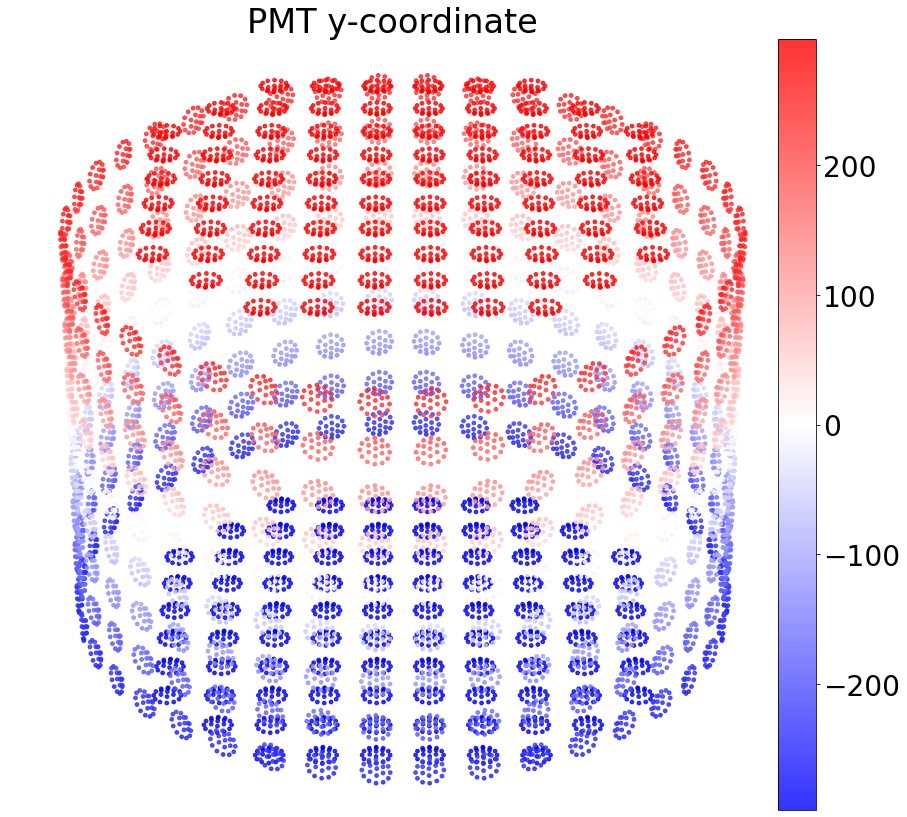

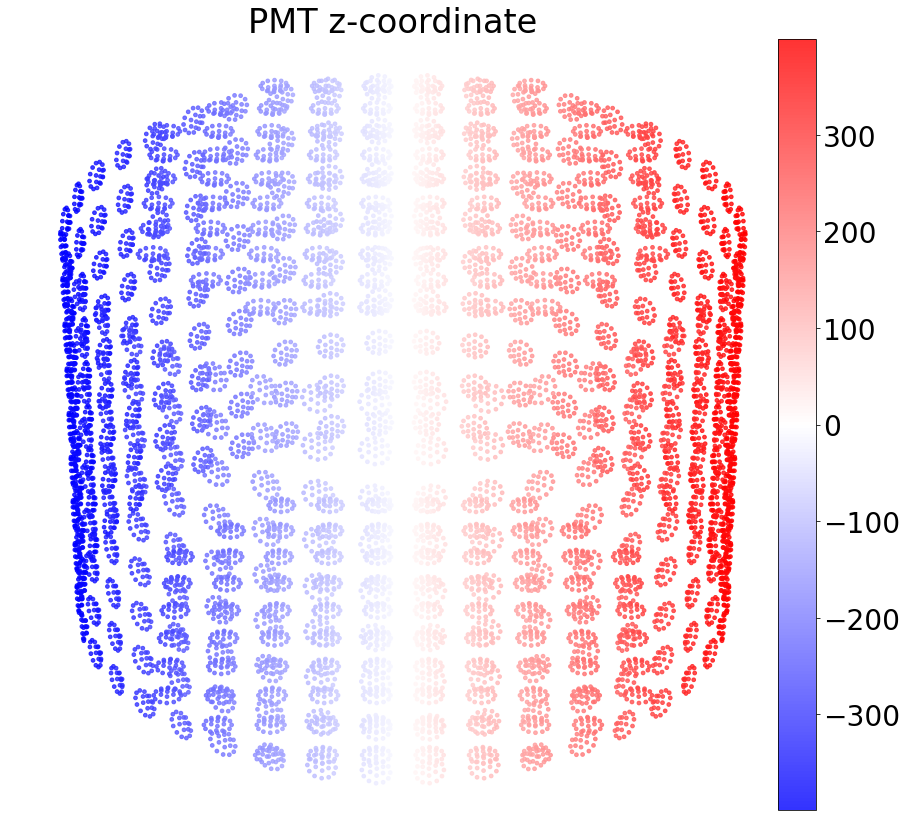

...

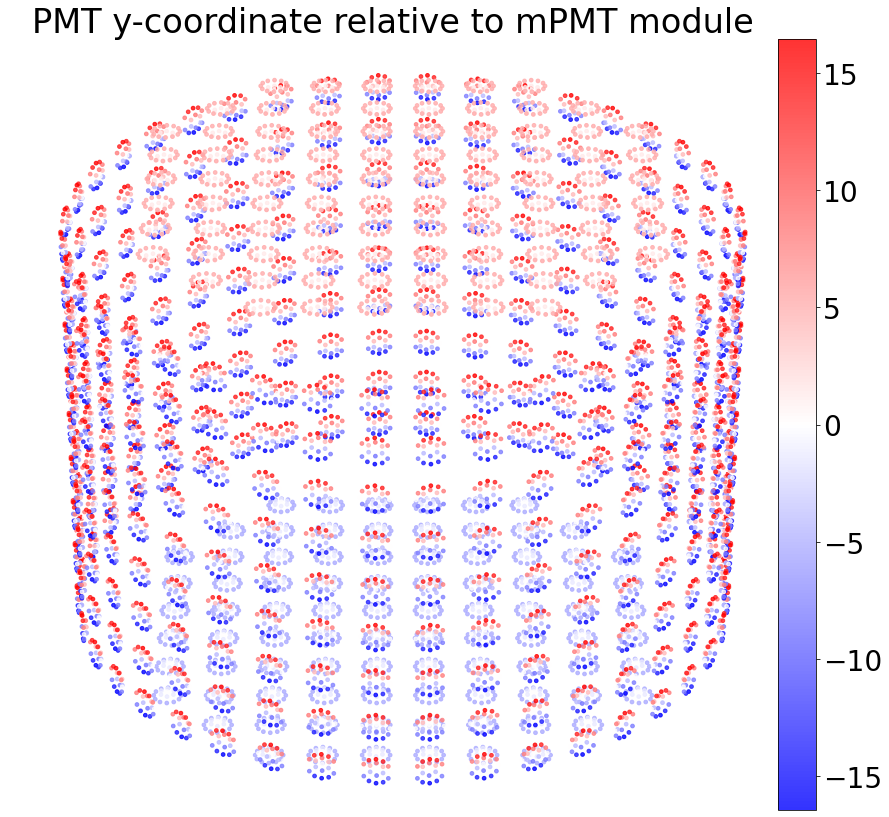

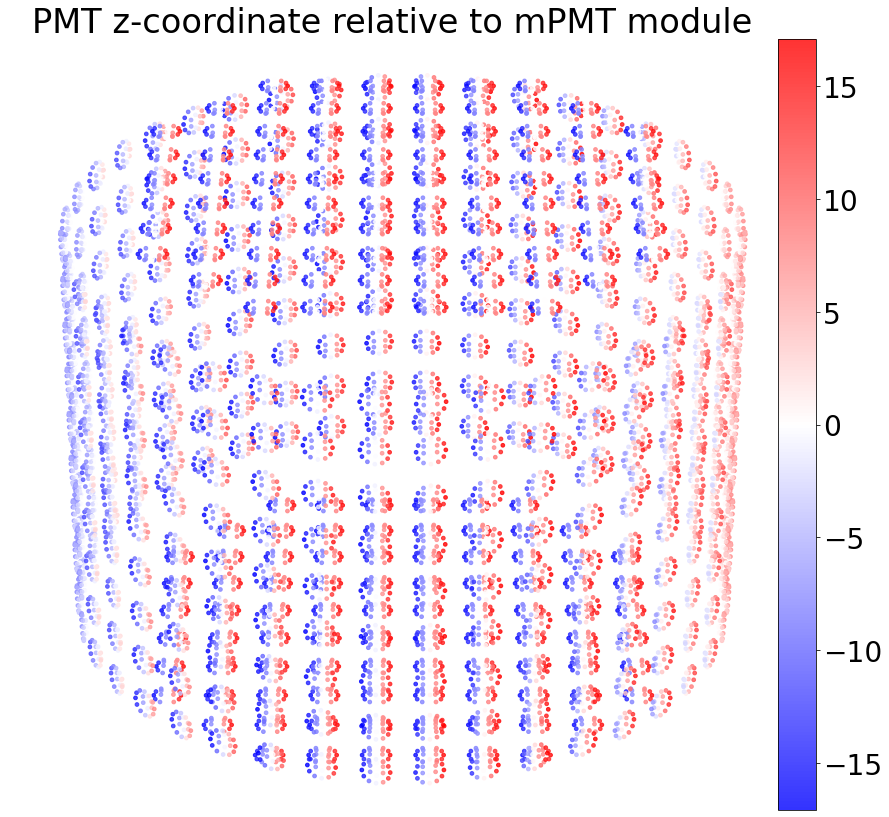

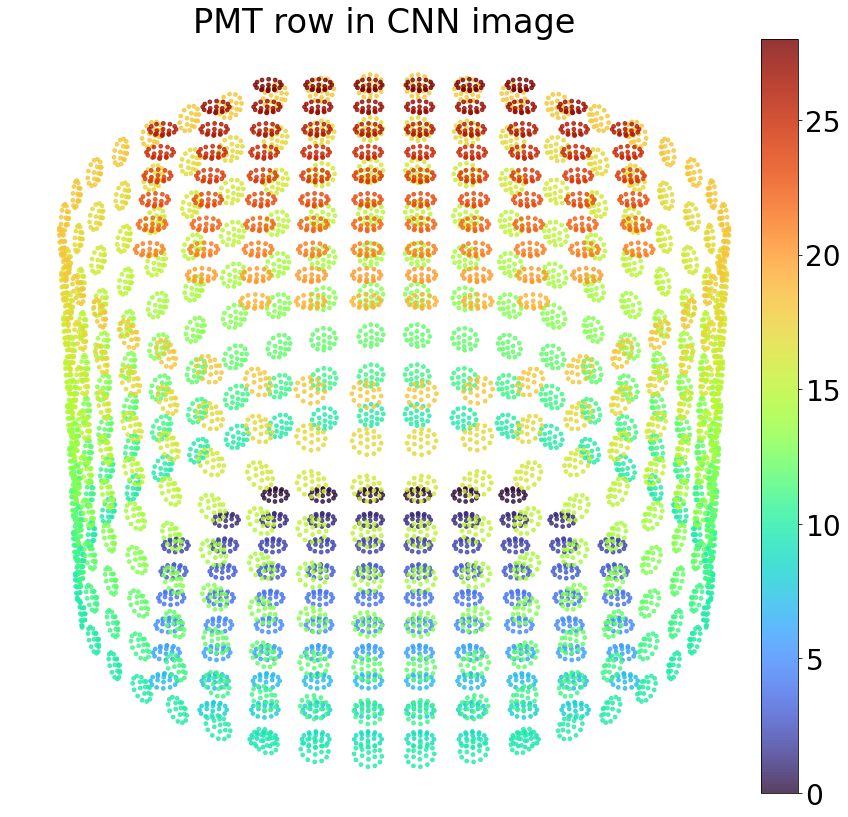

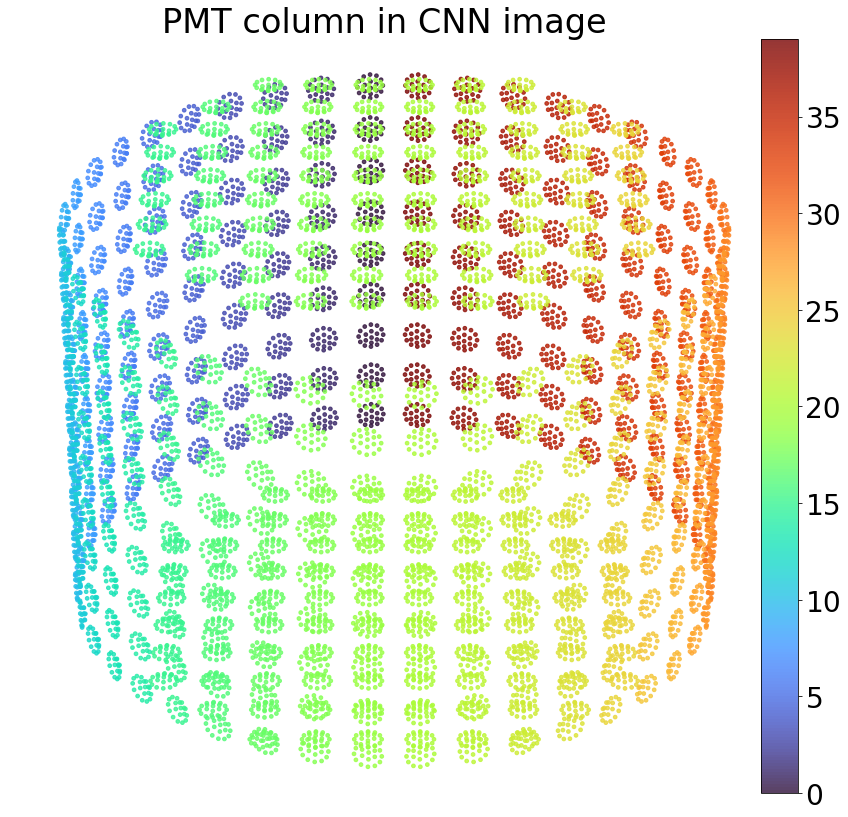

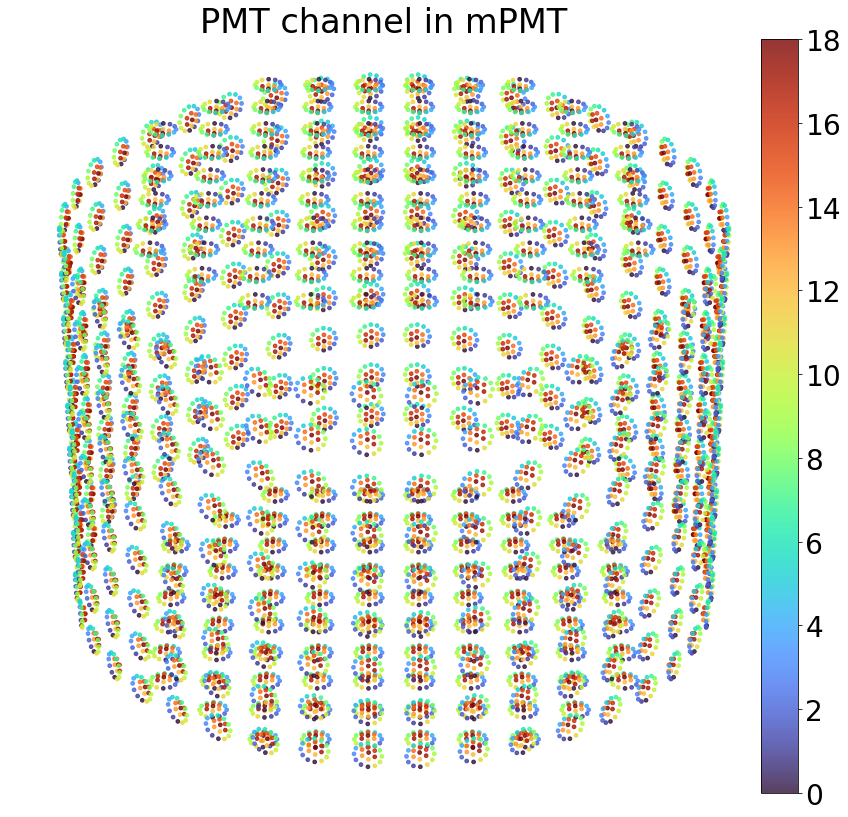

In [19]:
figs, axes = event_display.plot_geometry_3d(geo_positions_filename, plot=('1','i','x','y','z','dx','dy','dz','mx','my','mz','ir','ic','ch'))

View the geometry after transformation to check the transformation is working correctly:

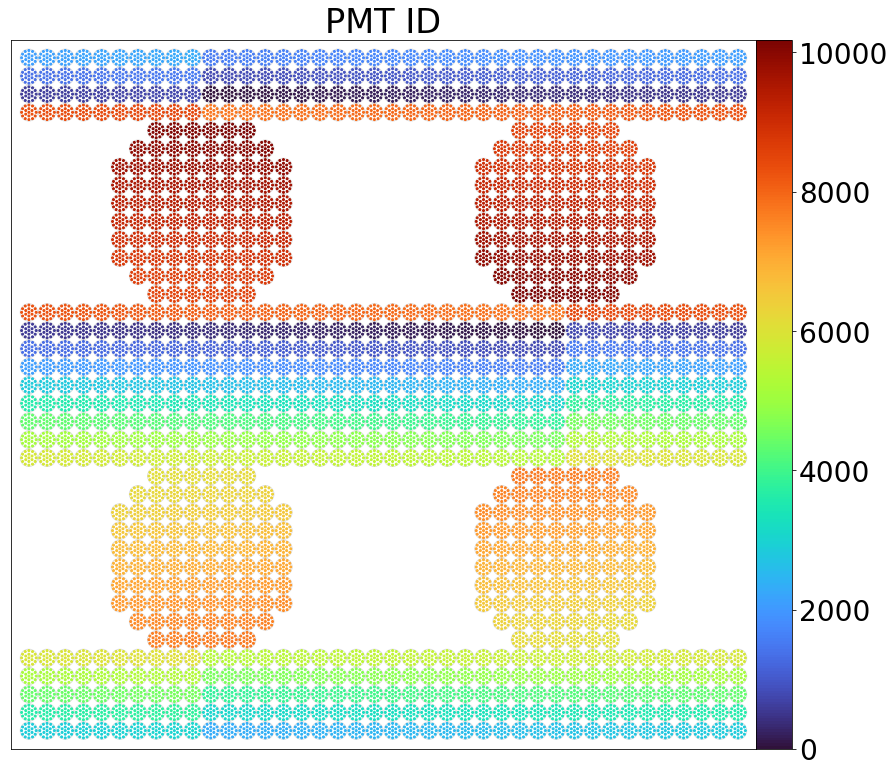

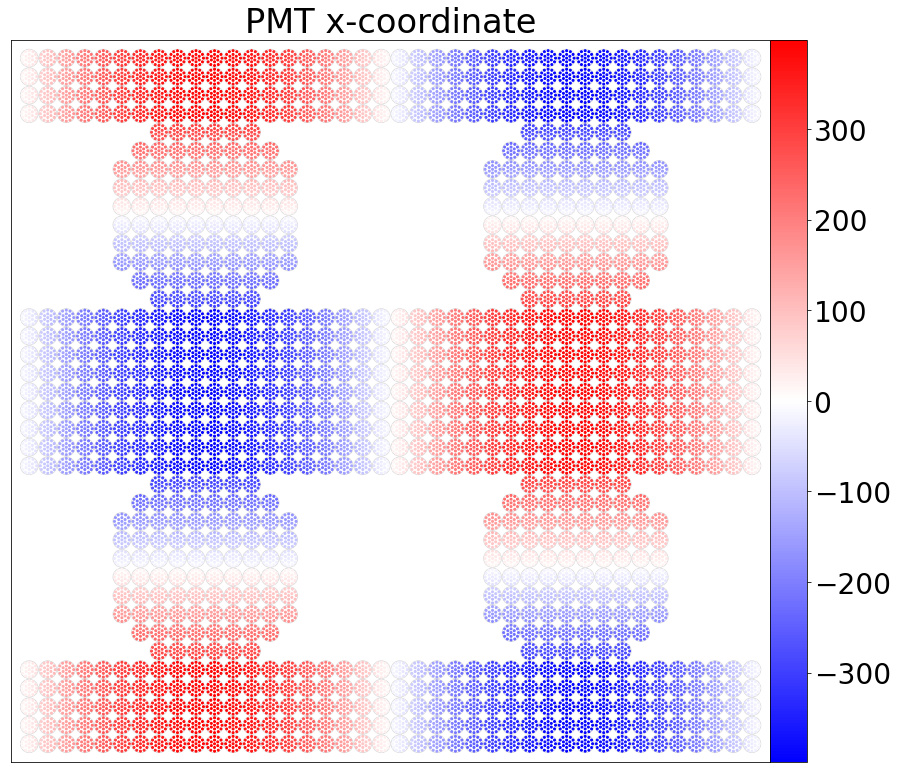

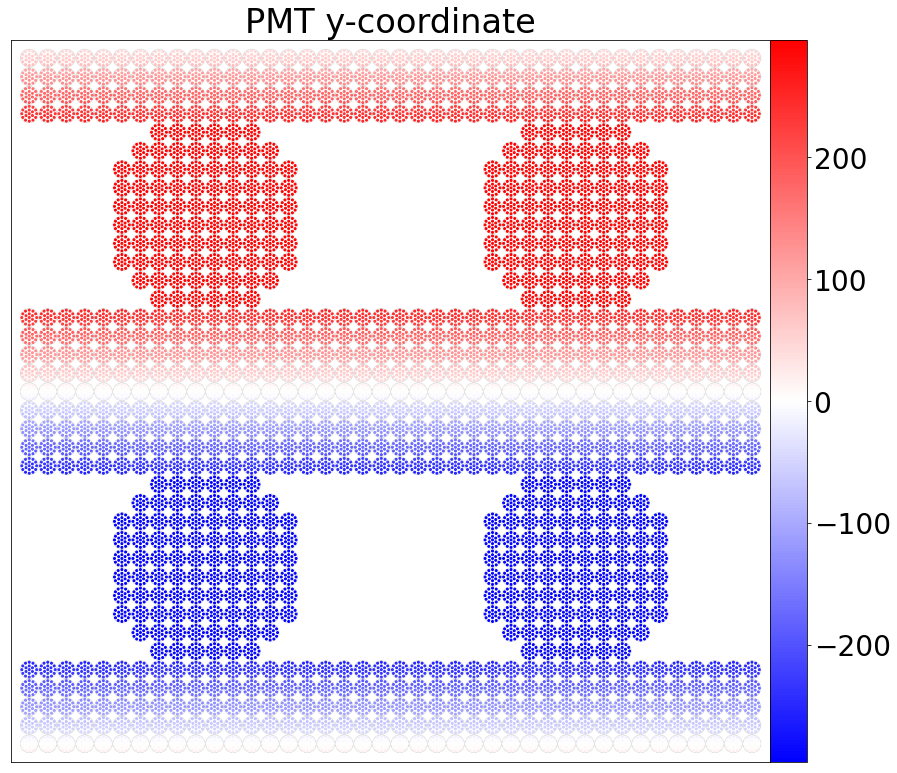

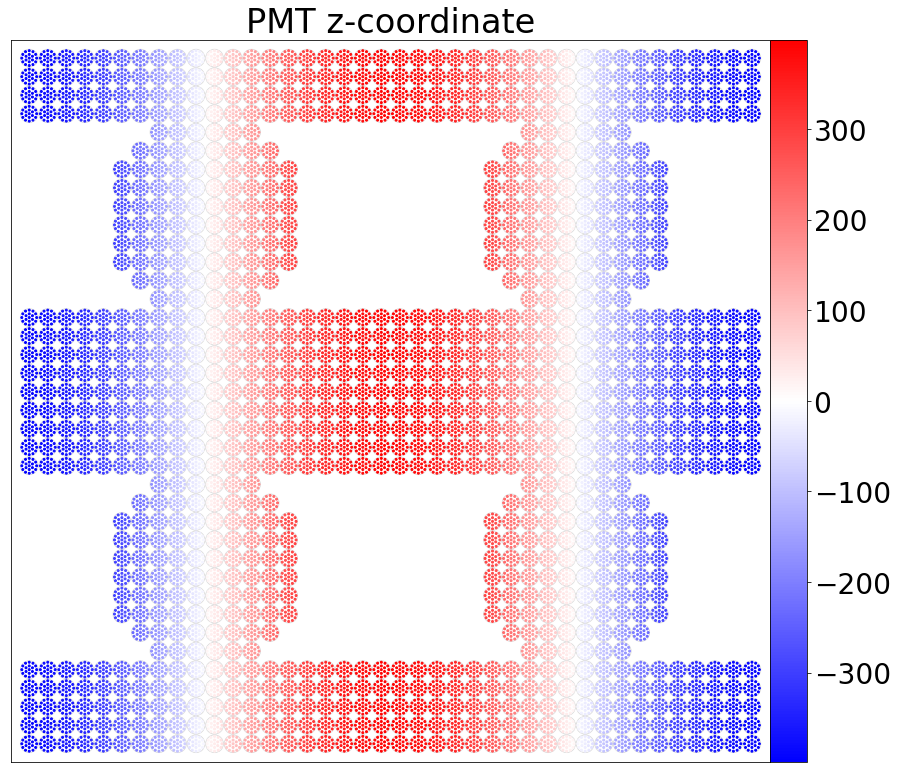

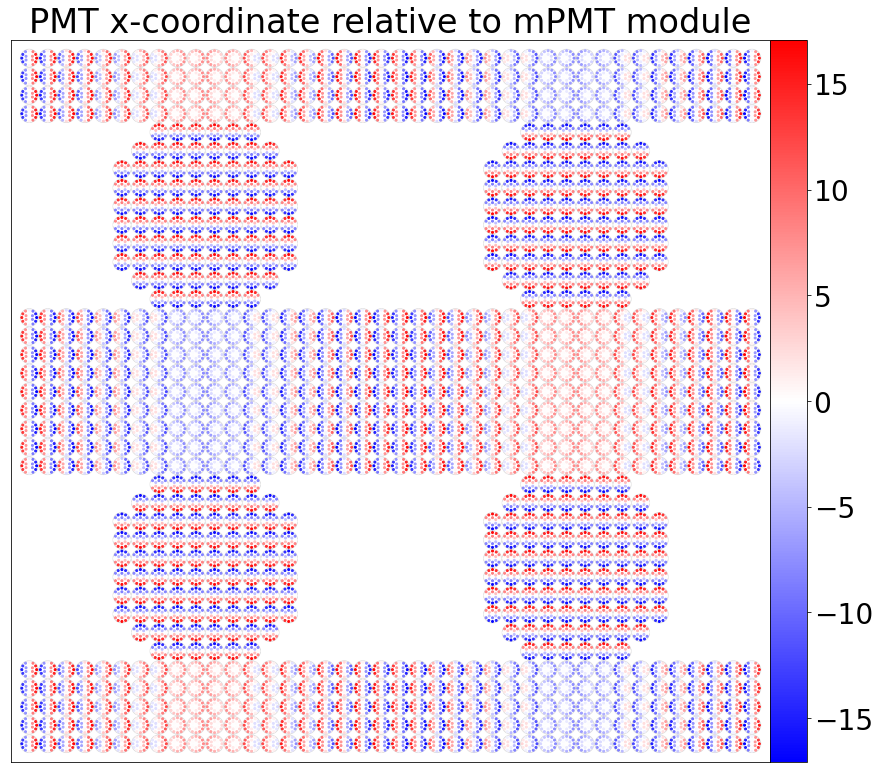

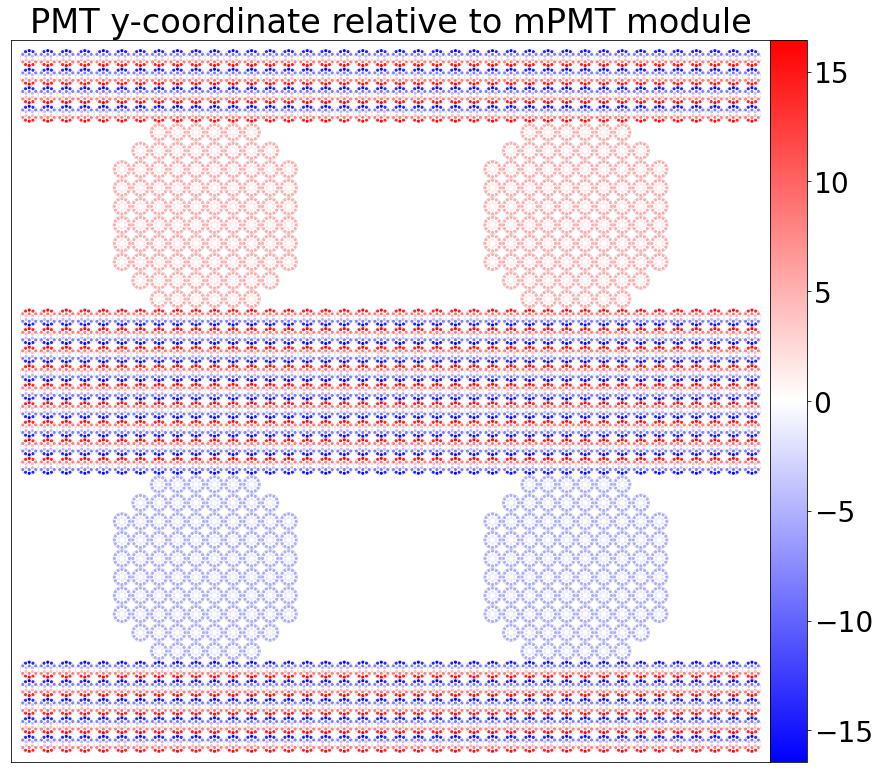

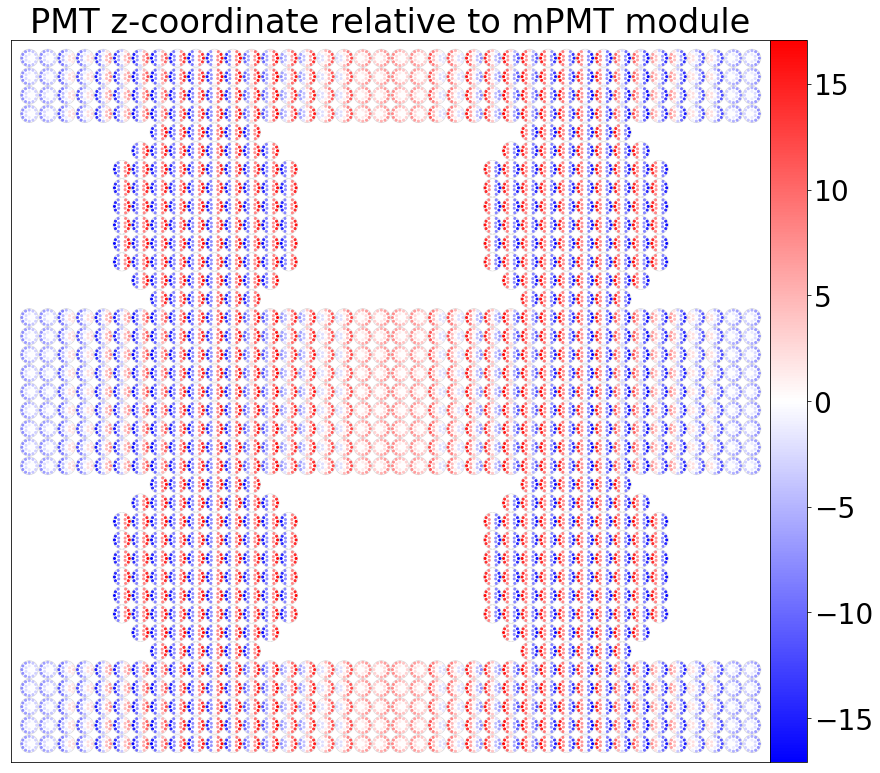

In [20]:
figs, axes = event_display.plot_geometry_2d(geo_positions_filename, plot=('i','x','y','z','mx','my','mz'), transformations="double_cover")

You can also make changes to the figure(s) returned by the plotting function.
Here we produce one plot, so take the first element of the returned list of figures and axes, remove the colorbar from the figure, make the axes visible, label them and set the padding so they don't overlap with the numbers.

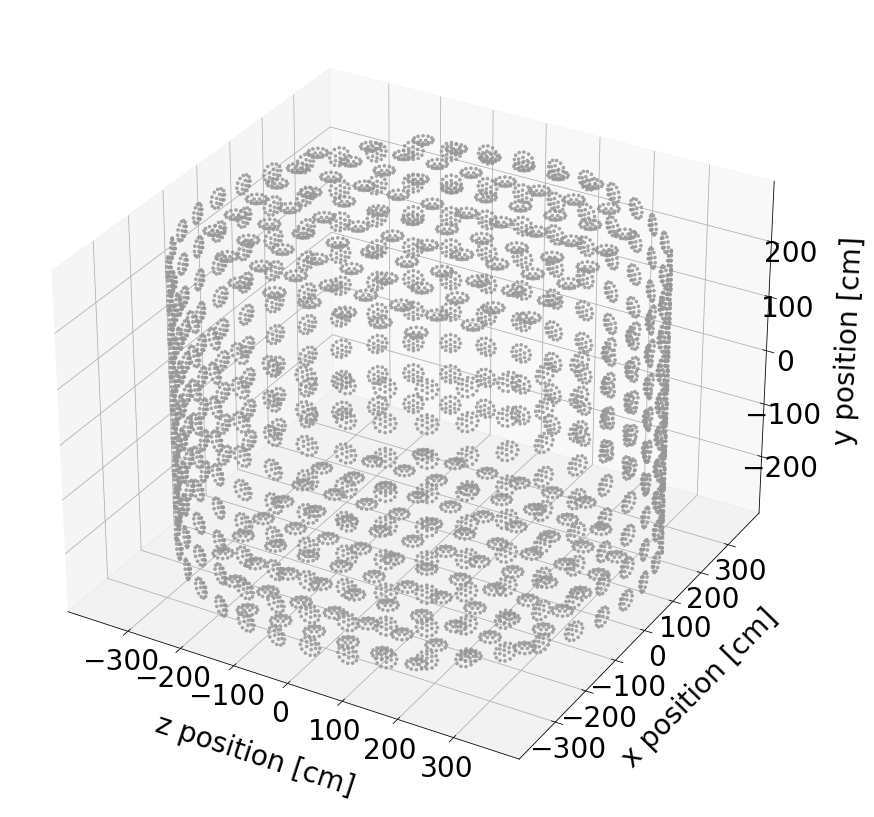

In [21]:
figs, axes = event_display.plot_geometry_3d(geo_positions_filename, plot=('1'), zoom=1, view_azimuth=-60)
fig, ax = figs[0], axes[0]  # it returns a list of figs and axes, but we take the first one since we only plotted one
for c in fig.get_children():
    if c.get_label()=="<colorbar>":
        c.remove()
ax.set_xlabel("x position [cm]")
ax.set_ylabel("y position [cm]")
ax.set_zlabel("z position [cm]")
ax.xaxis.labelpad=30
ax.yaxis.labelpad=30
ax.zaxis.labelpad=30
ax.set_axis_on()